In [3]:
!pip install comet_ml > /dev/null 2>&1
import comet_ml
# TODO: ENTER YOUR API KEY HERE!! instructions above
COMET_API_KEY = "jgAfW0bJBrLcH7HL7poln9ozz"

import torch
import torch.nn as nn
import torch.optim as optim

!pip install mitdeeplearning --quiet
import mitdeeplearning as mdl

import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
from scipy.io.wavfile import write
!apt-get install abcmidi timidity > /dev/null 2>&1

assert torch.cuda.is_available(), "Please enable GPU from runtime settings"
assert COMET_API_KEY != "", "Please insert your Comet API Key"

In [4]:
songs=mdl.lab1.load_training_data()
sample_song = songs[0]
print("\nExample song: ")
print(sample_song)

Found 817 songs in text

Example song: 
X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!


In [5]:
mdl.lab1.play_song(sample_song)

In [6]:
song_list="\n\n".join(songs)
vocab=sorted(set(song_list))
print("Unique characters in the dataset", vocab)

Unique characters in the dataset ['\n', ' ', '!', '"', '#', "'", '(', ')', ',', '-', '.', '/', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', ':', '<', '=', '>', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z', '[', ']', '^', '_', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', '|']


In [7]:
ch2idx={u: i for i, u in enumerate(vocab)}
idx2ch= np.array(vocab)

In [8]:
for char, _ in zip(ch2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), ch2idx[char]))

  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,


In [9]:
def vect_string(string):
  vect_output=np.array([ch2idx[ch] for ch in string])
  return vect_output
vect_songs=vect_string(song_list)

In [10]:
def get_batch(vec_songs, seq_len, batch_size):
  n= vect_songs.shape[0]-1
  idx= np.random.choice(n-seq_len,batch_size)

  input_batch = [vec_songs[i: i + seq_len] for i in idx]

  output_batch = [vec_songs[i + 1: i + seq_len + 1] for i in idx]

  x_batch=torch.tensor(input_batch, dtype=torch.long)
  y_batch=torch.tensor(output_batch, dtype=torch.long)

  return x_batch, y_batch

test_args = (vect_songs, 10, 2)
x_batch, y_batch = get_batch(*test_args)
assert x_batch.shape == (2, 10), "x_batch shape is incorrect"
assert y_batch.shape == (2, 10), "y_batch shape is incorrect"
print("Batch function works correctly!")

Batch function works correctly!


<ipython-input-10-fb19011f3dc2>:9: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /pytorch/torch/csrc/utils/tensor_new.cpp:254.)
  x_batch=torch.tensor(input_batch, dtype=torch.long)


In [11]:
x_batch, y_batch = get_batch(vect_songs, seq_len=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(x_batch[0], y_batch[0])):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2ch[input_idx.item()])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2ch[target_idx.item()])))

Step   0
  input: 1 (np.str_(' '))
  expected output: 62 (np.str_('g'))
Step   1
  input: 62 (np.str_('g'))
  expected output: 14 (np.str_('2'))
Step   2
  input: 14 (np.str_('2'))
  expected output: 61 (np.str_('f'))
Step   3
  input: 61 (np.str_('f'))
  expected output: 60 (np.str_('e'))
Step   4
  input: 60 (np.str_('e'))
  expected output: 82 (np.str_('|'))


In [12]:
class LSTMmodel(nn.Module):
  def __init__(self, vocab_size, embedding_dim, hidden_size):
    super(LSTMmodel, self).__init__()
    self.hidden_size = hidden_size

    #Layer 1 (aka Input Layer)
    self.embedding=nn.Embedding(vocab_size,embedding_dim)

    #Layer 2
    self.lstm= nn.LSTM(embedding_dim, hidden_size, batch_first=True)

    self.fc=nn.Linear(hidden_size,vocab_size)

  def init_hidden(self, batch_size, device):
    return (torch.zeros(1, batch_size, self.hidden_size).to(device),
            torch.zeros(1, batch_size, self.hidden_size).to(device))

  def forward(self, x, state=None, return_state=False):
    x=self.embedding(x)

    if state is None:
      state = self.init_hidden(x.size(0), x.device)
    out, state = self.lstm(x, state)

    out=self.fc(out)
    return out if not return_state else (out, state)


In [13]:
vocab_size= len(vocab)
embedding_dim=256
hidden_size=1024
batch_size=8

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model=LSTMmodel(vocab_size, embedding_dim, hidden_size).to(device)

print(model)

LSTMmodel(
  (embedding): Embedding(83, 256)
  (lstm): LSTM(256, 1024, batch_first=True)
  (fc): Linear(in_features=1024, out_features=83, bias=True)
)


In [21]:
x, y = get_batch(vect_songs, seq_len=100, batch_size=32)
x = x.to(device)
y = y.to(device)

pred = model(x)
print("Input shape:      ", x.shape,)
print("Prediction shape: ", pred.shape,)

Input shape:       torch.Size([32, 100])
Prediction shape:  torch.Size([32, 100, 83])


In [22]:
# Results from the untrained model

sampled_indices= torch.multinomial(torch.softmax(pred[0], dim=-1), num_samples=1)
sampled_indices= sampled_indices.squeeze(-1).cpu().numpy()
sampled_indices

array([39, 28,  9, 44, 42, 14, 53, 26, 40, 59, 46,  2, 78, 23, 31, 63, 63,
       34, 41, 51, 15, 21,  6,  0, 22, 14, 46,  7, 48, 43,  9, 16, 12,  2,
       30, 61,  0, 64, 80, 27,  1, 60, 44, 60, 79, 62, 36,  6,  7, 27, 74,
       25, 25, 33, 17, 27,  3, 39, 47, 12, 51,  4, 31, 27,  1, 53, 81, 38,
       59, 68, 53, 37, 63, 34, 34, 38, 58, 50, 50, 41, 76, 75,  3, 63, 39,
       44, 34, 19, 51, 42, 12, 52, 25, 62,  6, 23, 63, 17, 69, 50])

In [24]:
#Results from the untrained model are pretty trash

print("Input: \n", repr("".join(idx2ch[x[0].cpu()])))
print()
print("Next Char Predictions: \n", repr("".join(idx2ch[sampled_indices])))

Input: 
 'f gfeg|fedf edBc|dBAF DEFB|ABde fee2|!\nf2af gfeg|fedf edBc|dBAF DEFB|ABde fdd:|!\n\nX:216\nT:Martin Wyn'

Next Char Predictions: 
 'NC-SQ2]AOdU!w<FhhIPZ39(\n:2U)WR-40!Ef\niyB eSexgK()Bs>>H5B"NV0Z#FB ]zMdm]LhIIMcYYPut"hNSI7ZQ0[>g(<h5nY'


In [25]:
cross_entropy= nn.CrossEntropyLoss()

def compute_loss(labels, logits):

  batched_labels=labels.view(-1)

  batched_logits = logits.view(-1, logits.size(-1))

  loss=cross_entropy(batched_logits, batched_labels)
  return loss

In [27]:
y.shape
pred.shape

example_loss=compute_loss(y, pred)
print("Prediction size: ",pred.shape)
print("Scalar loss: ",example_loss.mean().item())

Prediction size:  torch.Size([32, 100, 83])
Scalar loss:  4.425198554992676


In [28]:
vocab_size= len(vocab)
#Model Parameters
params = dict(
  num_training_iterations = 3000,  # Increase this to train longer
  batch_size = 8,  # Experiment between 1 and 64
  seq_len = 100,  # Experiment between 50 and 500
  learning_rate = 5e-3,  # Experiment between 1e-5 and 1e-1
  embedding_dim = 256,
  hidden_size = 1024,  # Experiment between 1 and 2048
)

checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")
os.makedirs(checkpoint_dir, exist_ok=True)

In [34]:
def create_exp():
  if 'experiment' in locals():
    experiment.end()

  experiment = comet_ml.Experiment(
                  api_key=COMET_API_KEY,
                  project_name="RNN_Music")
  for param, value in params.items():
    experiment.log_parameter(param, value)
  experiment.flush()

  return experiment

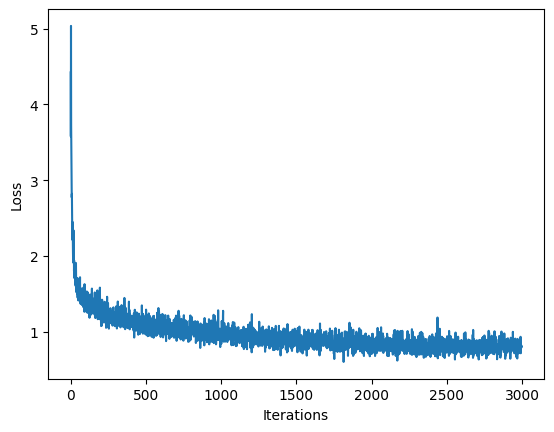

100%|██████████| 3000/3000 [01:29<00:00, 33.37it/s]
COMET INFO: Uploading 177 metrics, params and output messages


True

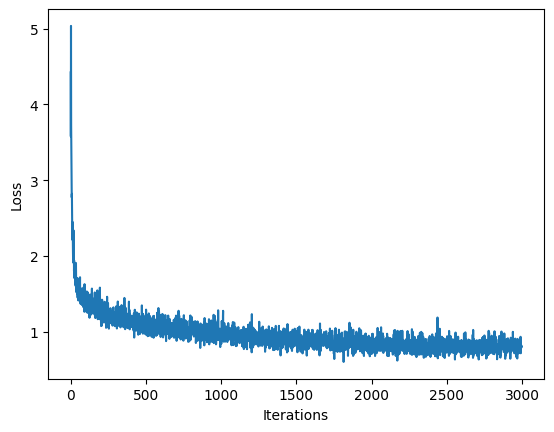

In [35]:
model = LSTMmodel(vocab_size, params['embedding_dim'], params['hidden_size'])
model.to(device)

optimizer= torch.optim.Adam(model.parameters(), lr=params['learning_rate'])

def train_step(x,y):
  model.train()
  model.zero_grad()
  y_hat=model(x)
  loss=compute_loss(y,y_hat)
  loss.backward()
  optimizer.step()

  return loss

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
experiment = create_exp()

if hasattr(tqdm, '_instances'): tqdm._instances.clear()
for iter in tqdm(range(params["num_training_iterations"])):
  x_batch, y_batch = get_batch(vect_songs, params["seq_len"], params["batch_size"])

  x_batch = torch.tensor(x_batch, dtype=torch.long).to(device)
  y_batch = torch.tensor(y_batch, dtype=torch.long).to(device)
  loss =train_step(x_batch, y_batch)

  experiment.log_metric("loss", loss.item(), step=iter)

  history.append(loss.item())
  plotter.plot(history)

  if iter % 100 == 0:
    torch.save(model.state_dict(), checkpoint_prefix)
torch.save(model.state_dict(), checkpoint_prefix)
experiment.flush()

In [38]:
def generate_text(model, start_string, generation_length=1000):
  input_idx = [ch2idx[s] for s in start_string]
  input_idx = torch.tensor([input_idx], dtype=torch.long).to(device)

  state = model.init_hidden(input_idx.size(0), device)

  text_generated = []
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
    predictions, state = model(input_idx, state, return_state=True)

    predictions = predictions.squeeze(0)

    input_idx = torch.multinomial(torch.softmax(predictions, dim=-1), num_samples=1)

    text_generated.append(idx2ch[input_idx].item())


  return (start_string + ''.join(text_generated))

In [39]:
generated_text = generate_text(model, start_string="X", generation_length=1000)

100%|██████████| 1000/1000 [00:00<00:00, 1428.90it/s]


In [40]:
generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs):
  waveform = mdl.lab1.play_song(song)

  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

    numeric_data = np.frombuffer(waveform.data, dtype=np.int16)
    wav_file_path = f"output_{i}.wav"
    write(wav_file_path, 88200, numeric_data)

    experiment.log_asset(wav_file_path)

Found 1 songs in text
Generated song 0


In [41]:
experiment.end()


COMET WARNING: Couldn't retrieve and log Google Colab notebook content, reason: 'NoneType' object is not subscriptable
COMET INFO: ---------------------------------------------------------------------------------------
COMET INFO: Comet.ml Experiment Summary
COMET INFO: ---------------------------------------------------------------------------------------
COMET INFO:   Data:
COMET INFO:     display_summary_level : 1
COMET INFO:     name                  : mathematical_swordfish_3470
COMET INFO:     url                   : https://www.comet.com/saransh1578/rnn-music/03f57be7f9a34ff58cbe5c408df264c6
COMET INFO:   Metrics [count] (min, max):
COMET INFO:     loss [3300] : (0.6022981405258179, 5.036840438842773)
COMET INFO:   Others:
COMET INFO:     notebook_url : https://colab.research.google.com/notebook#fileId=1cOvZnsqbO0R6Pl0uI5UHVxwtjDUrumpa
COMET INFO:   Parameters:
COMET INFO:     batch_size              : 8
COMET INFO:     embedding_dim           : 256
COMET INFO:     hidden_size  